# 3DeeCellTracker Demo: Train 3D U-Net
This notebook shows how to use 3DeeCellTracker to train a 3D U-Net.
The demo data can be found in the "unet_training" folder downloaded from https://osf.io/dt76c/

The basic procedures:

- A. Import packages
- B. Initialize the parameters for training
- C. Load the train / validation datasets
- D. Preprocess the datasets
- E. Train the 3D U-Net
- F. Select the best weights and save the model

Please run following codes according to the instructions

## A. Import packages

In [1]:
%load_ext autoreload
%autoreload 2
import os
import warnings
warnings.filterwarnings('ignore')
from CellTracker.unet3d import TrainingUNet3D, unet3_a
%matplotlib inline

## B. Initialize the parameters for training
- noise_level: This value should be roughly the intensity of the background pixels in the raw image. It is used in
normalization to enhance the cells with weak intensity while ignore the background noises. If the two images (train and
validation) have different noise level, choose a value somehow between them.

- folder_path: This path is used to create a folder (if not exist) to store the data and model files. We recommend users
to set it as “./xxxx” to create a folder named xxxx under the same directory containing the notebook file.

- model: This should be a predefined 3D U-Net model. The simplest way is to use the default value unet3_a(). Advanced
users can select other predefined model such as unet3_b(), unet3_c(), or a model defined by themselves (need to modify
the “Import packages” cell to import the model).

In [2]:
trainer = TrainingUNet3D(noise_level=100, folder_path=os.path.abspath("./unet_01"), model=unet3_a())

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Made folders under: C:\Users\vislabwwy\BAAI-Dev\3dct_for_pku_ldg\Examples
Following folders were made: 
unet_01\train_image
unet_01\train_label
unet_01\valid_image
unet_01\valid_label
unet_01\models
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## C. Load the train / validation datasets

After running B, the program automatically generated several folders under the folder_path. Users should prepare the
training data and validation data (see examples in the demo data) and store them into the “train_image”(raw 2D image
sequence for training data), “train_label”(2D annotation of cell/non-cell regions for training data), “valid_image” and
“valid_label” (for validation data), respectively.


Run the code cell. The program will load and draw the images/annotations of the training and validation dataset by max-projection.

Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)


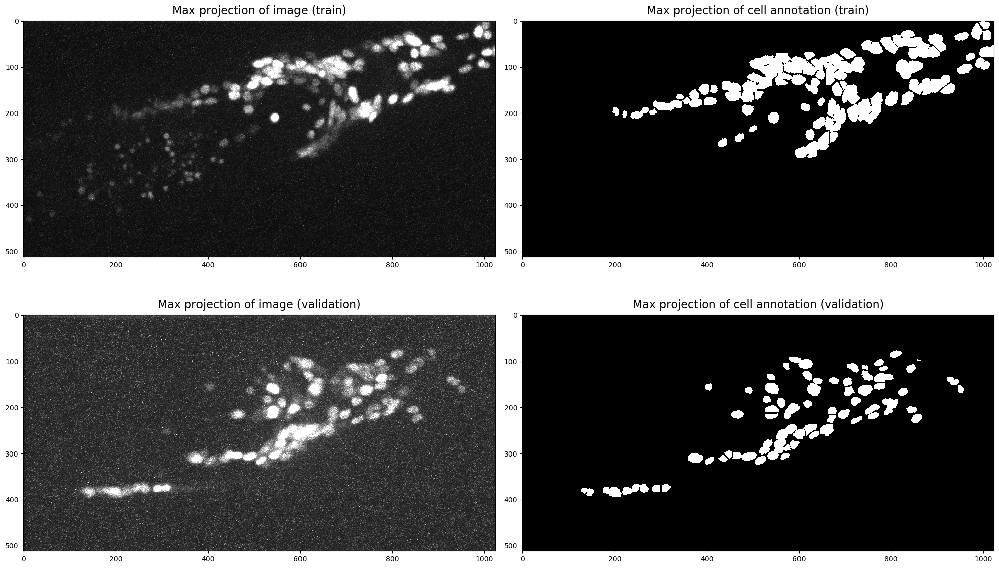

In [3]:
trainer.load_dataset()
trainer.draw_dataset()

## D. Preprocess the datasets
**D1. Show the normalized images (max projection)**

Normalize the images and show the normalized images.
If the normalization looks poor, e.g. the background look too bright, or the intensity of weak cells are not enhanced.
Please go back to step B to modify the parameter “noise_level” and run all codes again.

Images were normalized
Images were divided
Data for training 3D U-Net were prepared


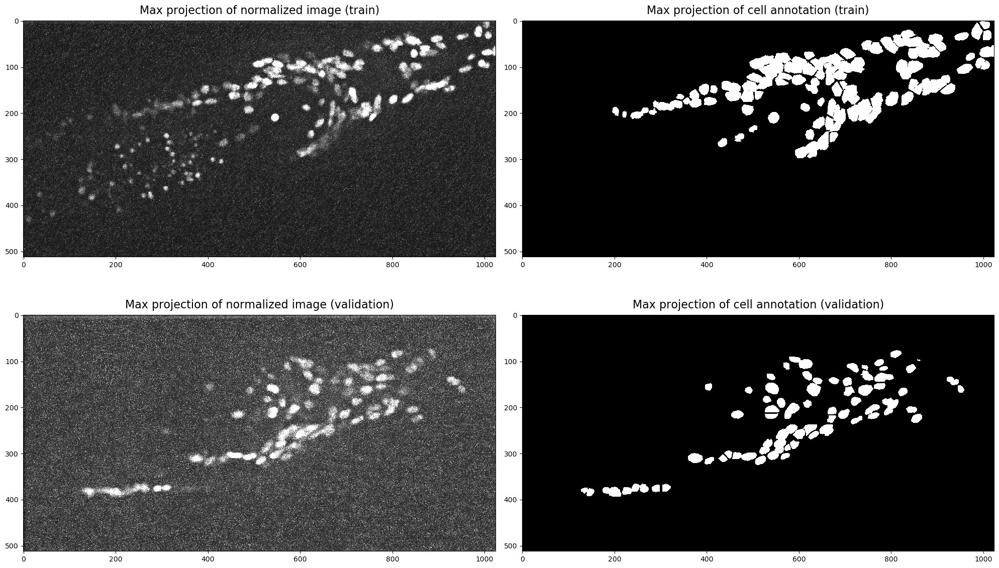

In [4]:
trainer.preprocess()
trainer.draw_norm_dataset()

**D2. Show the divided images (part)**

Divide the images into multiple sub-images (used as the input of 3D U-Net) and show a part of these sub-images.

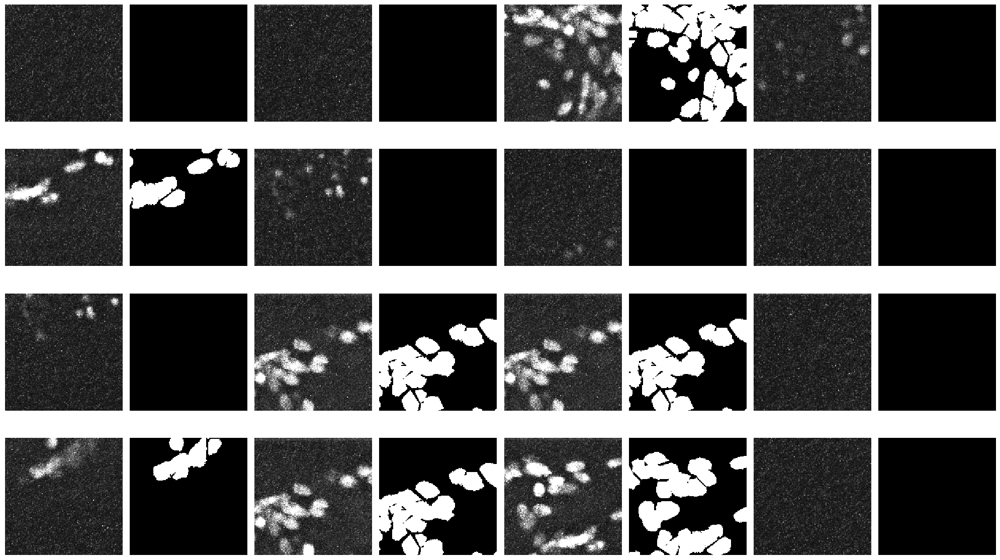

In [5]:
trainer.draw_divided_train_data()

## E. Train the 3D U-Net
Start to train the 3D U-Net. During the training, the program will draw the updated prediction of cell regions if the
loss on validation data is reduced.

By default, the program will train for 100 epochs. Users can manually stop the training by pressing Ctrl+C if the
val_loss no longer decreases anymore.

60/60 [==============================] - 60s 995ms/step - loss: 0.6429 - val_loss: 0.6420
val_loss at step 1:  0.6419716642962562


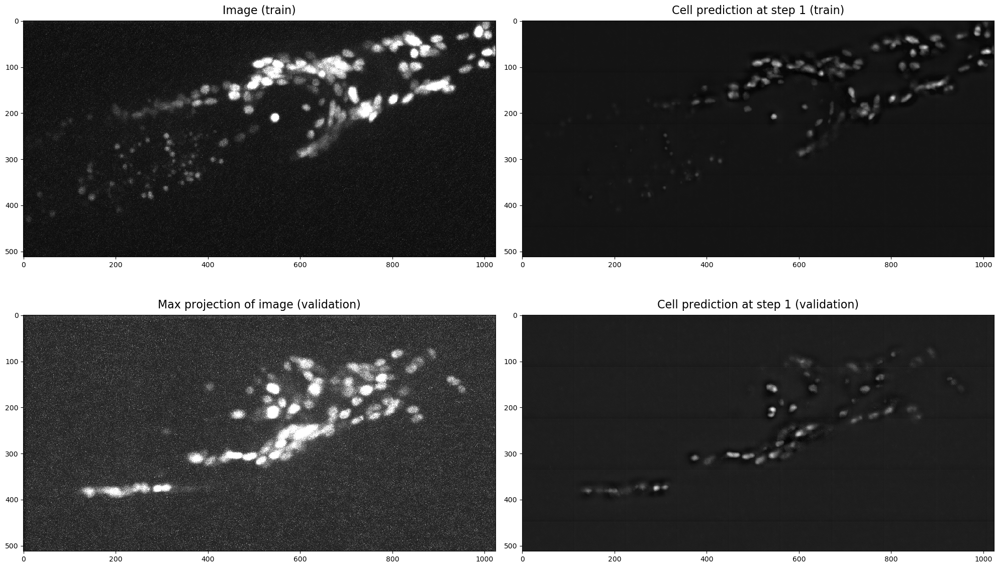

60/60 [==============================] - 50s 828ms/step - loss: 0.5308 - val_loss: 0.3975
val_loss updated from  0.6419716642962562  to  0.39751296242078143


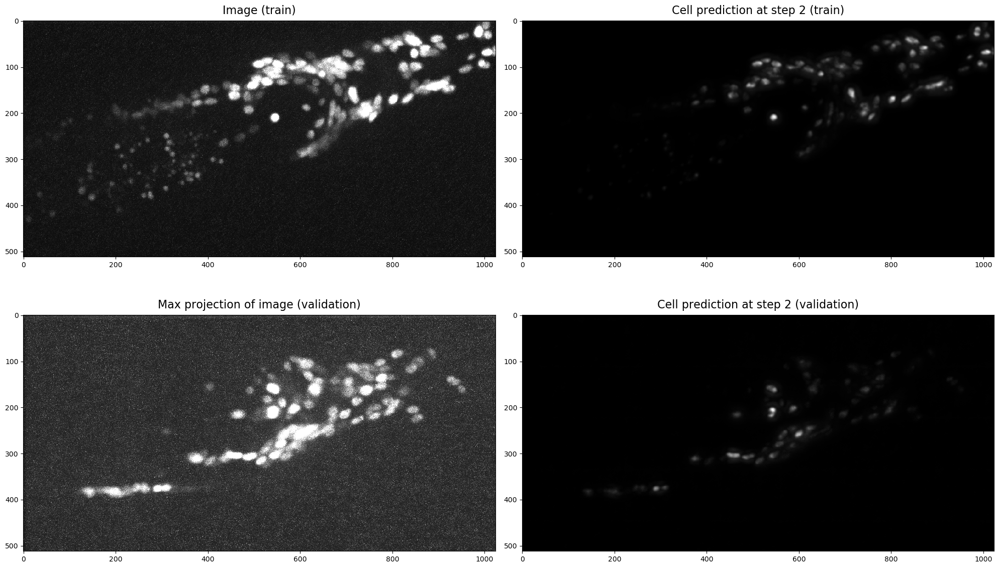

60/60 [==============================] - 51s 856ms/step - loss: 0.4184 - val_loss: 0.2582
val_loss updated from  0.39751296242078143  to  0.25816284368435544


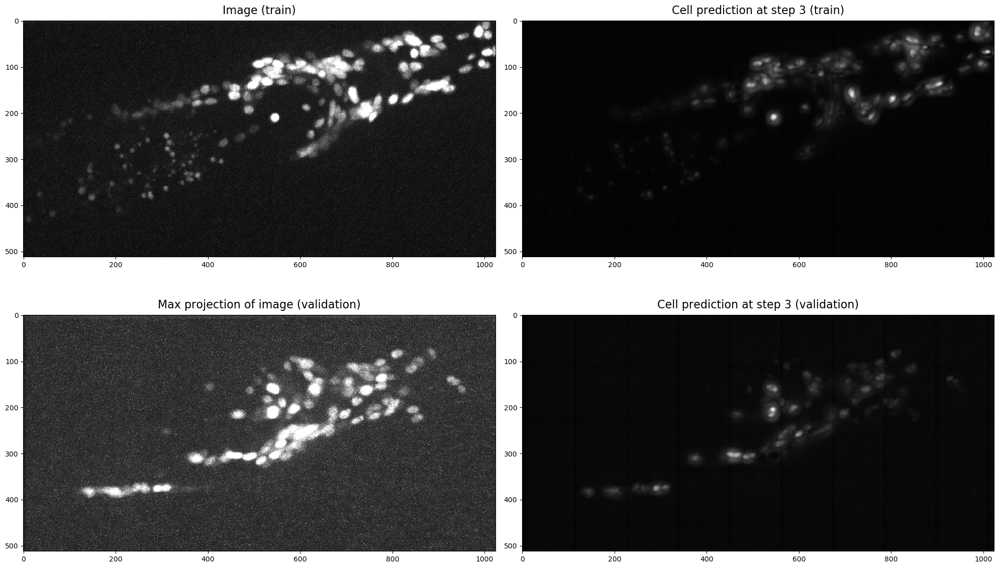

60/60 [==============================] - 52s 870ms/step - loss: 0.3120 - val_loss: 0.1866
val_loss updated from  0.25816284368435544  to  0.18656930575768152


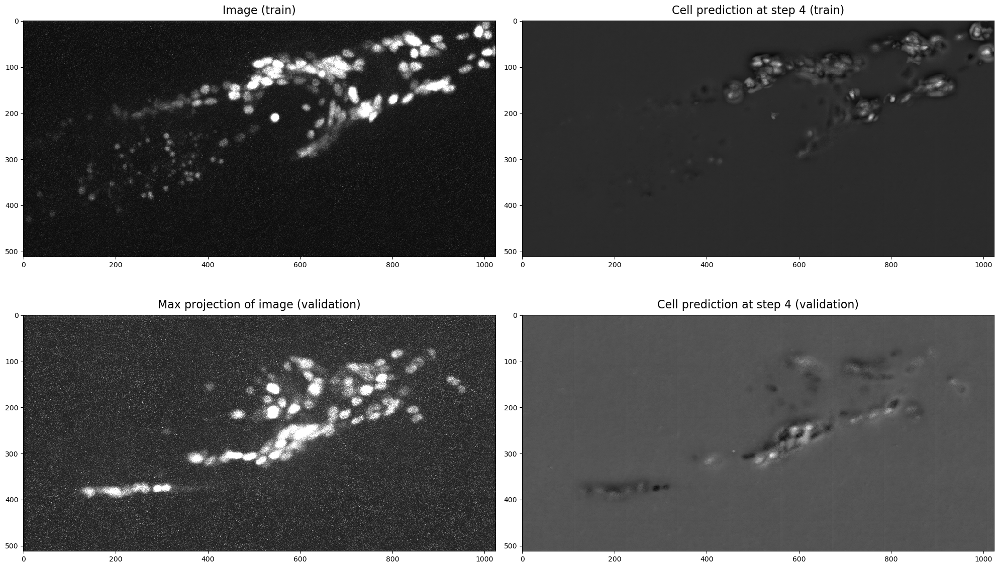

60/60 [==============================] - 55s 911ms/step - loss: 0.1704 - val_loss: 0.1158
val_loss updated from  0.18656930575768152  to  0.11581016745832232


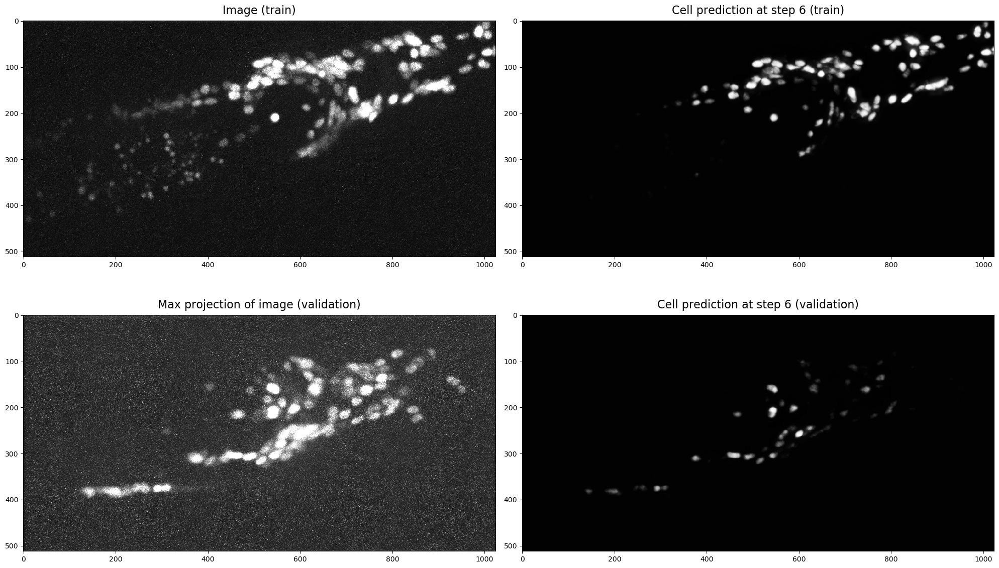

60/60 [==============================] - 52s 862ms/step - loss: 0.1227 - val_loss: 0.0835
val_loss updated from  0.11581016745832232  to  0.08349998543659846


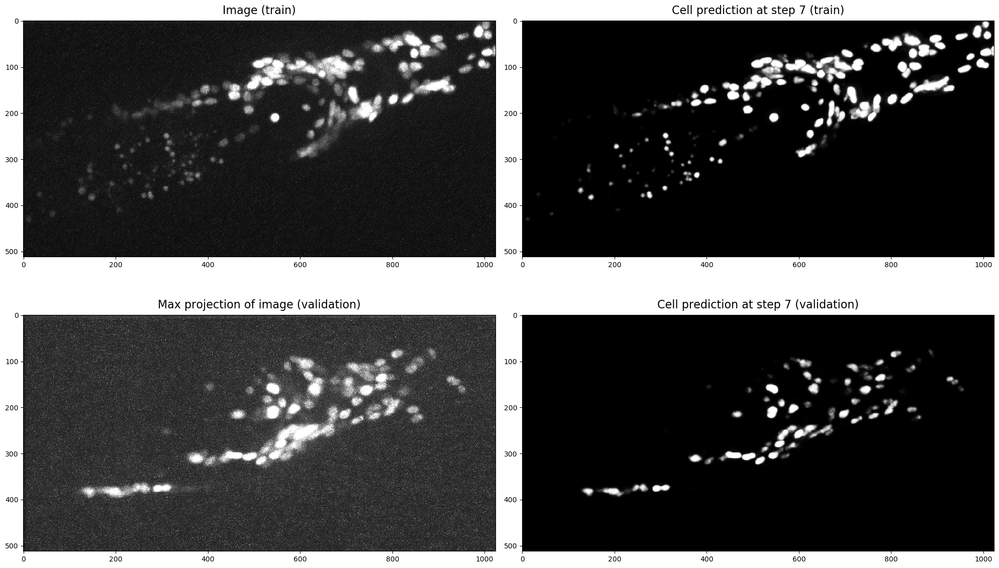

60/60 [==============================] - 52s 864ms/step - loss: 0.0931 - val_loss: 0.0656
val_loss updated from  0.08349998543659846  to  0.06559382151398394


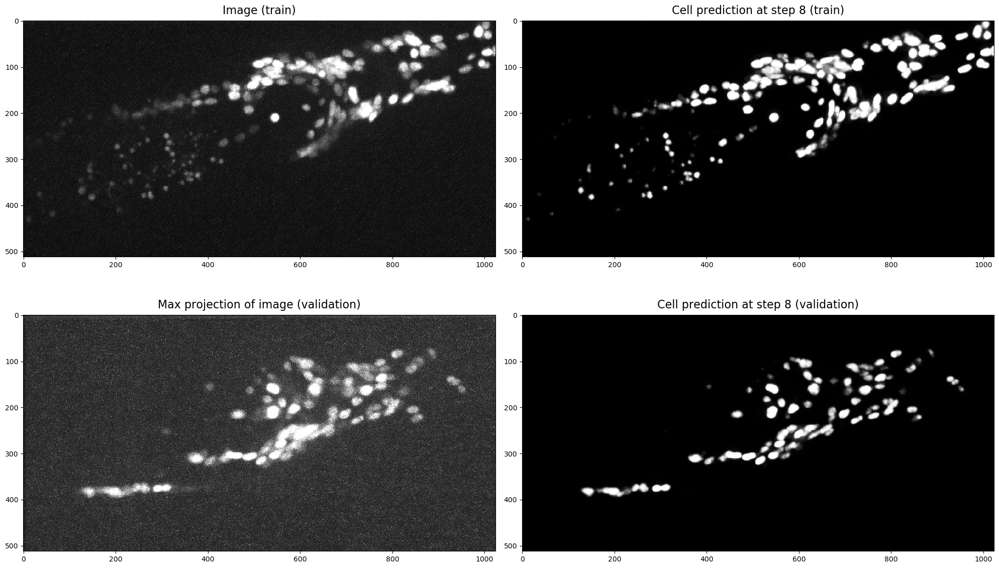

60/60 [==============================] - 52s 864ms/step - loss: 0.0767 - val_loss: 0.0534
val_loss updated from  0.06559382151398394  to  0.05344057559139199


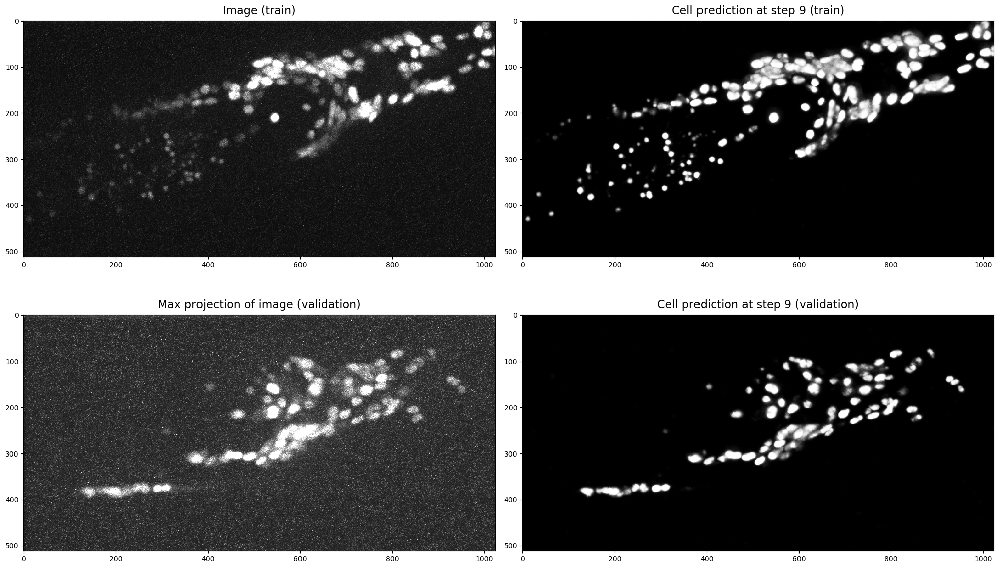

60/60 [==============================] - 51s 857ms/step - loss: 0.0655 - val_loss: 0.0469
val_loss updated from  0.05344057559139199  to  0.04694268335070875


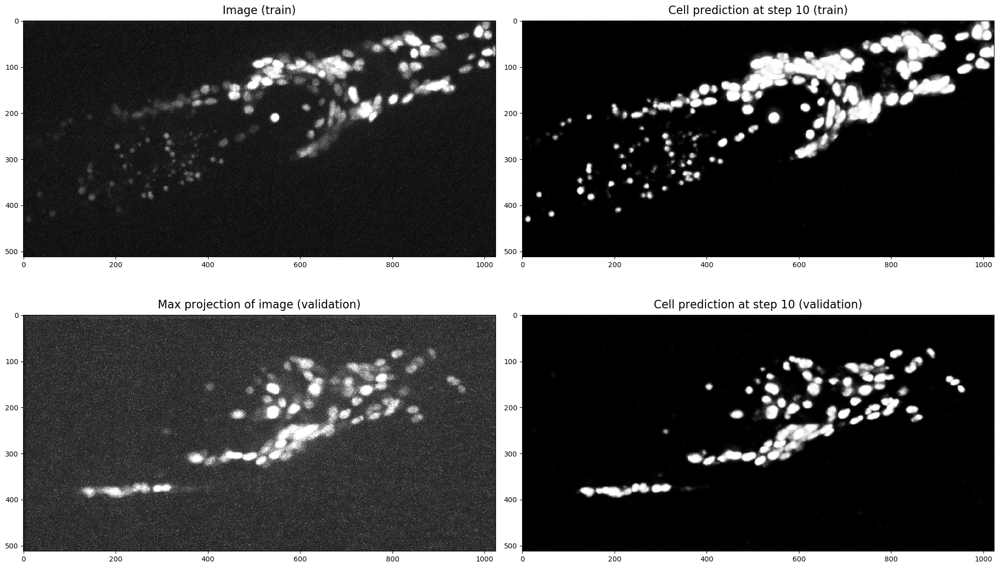

60/60 [==============================] - 52s 871ms/step - loss: 0.0555 - val_loss: 0.0360
val_loss updated from  0.04694268335070875  to  0.03601795745392641


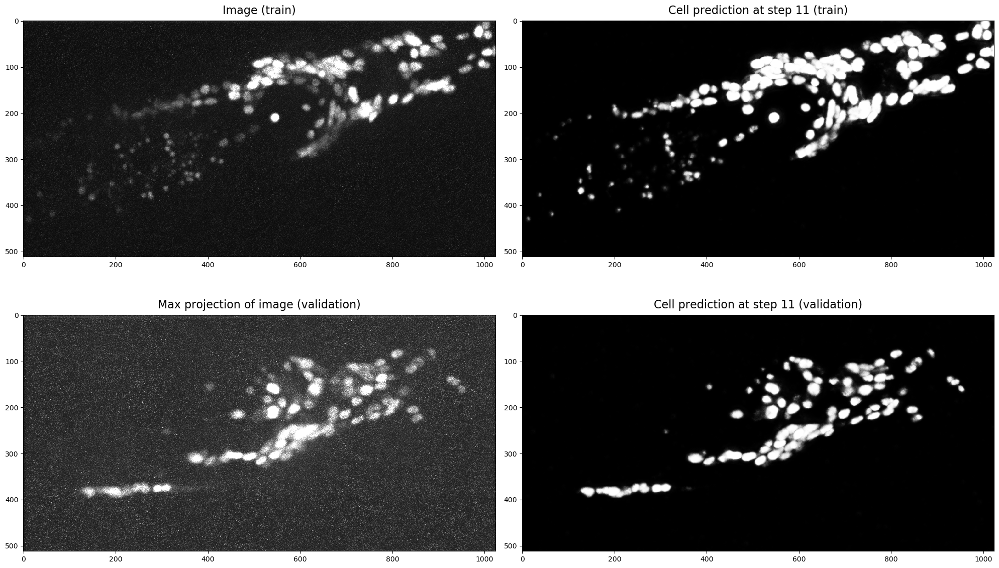

60/60 [==============================] - 54s 893ms/step - loss: 0.0458 - val_loss: 0.0291
val_loss updated from  0.03601795745392641  to  0.02910386977924241


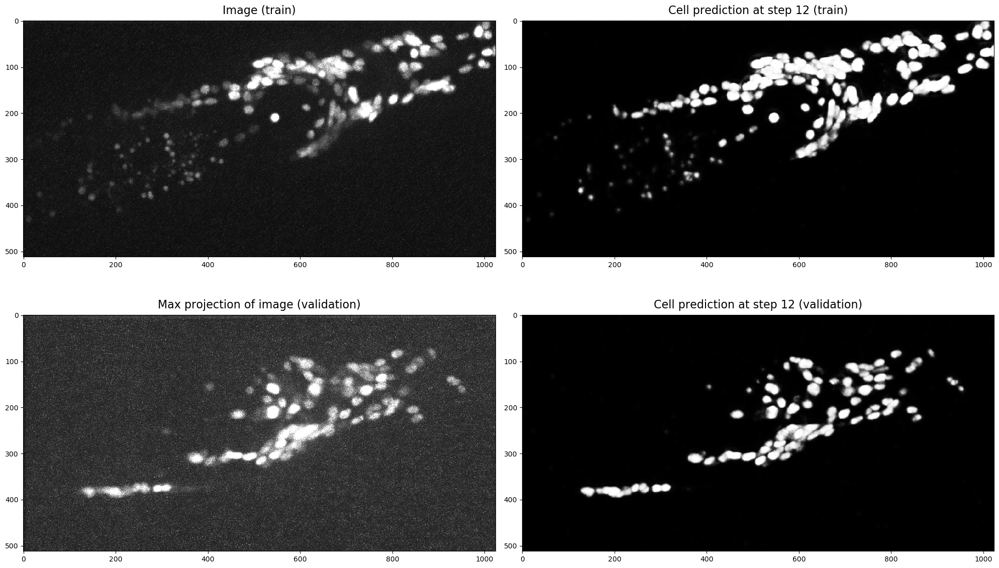

60/60 [==============================] - 50s 837ms/step - loss: 0.0368 - val_loss: 0.0151
val_loss updated from  0.02910386977924241  to  0.01512144493042595


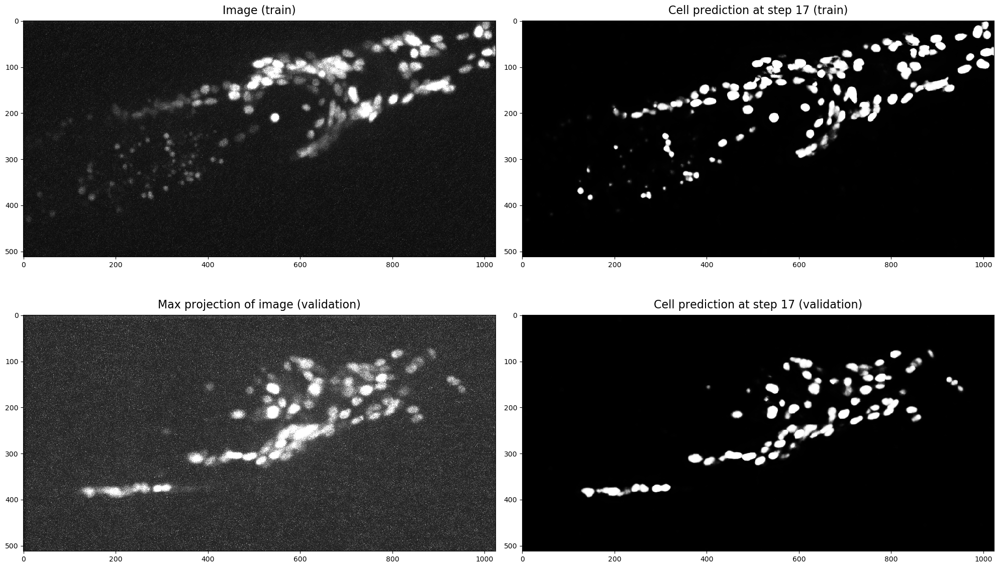

60/60 [==============================] - 50s 833ms/step - loss: 0.0206 - val_loss: 0.0135
val_loss updated from  0.01512144493042595  to  0.013476755091687664


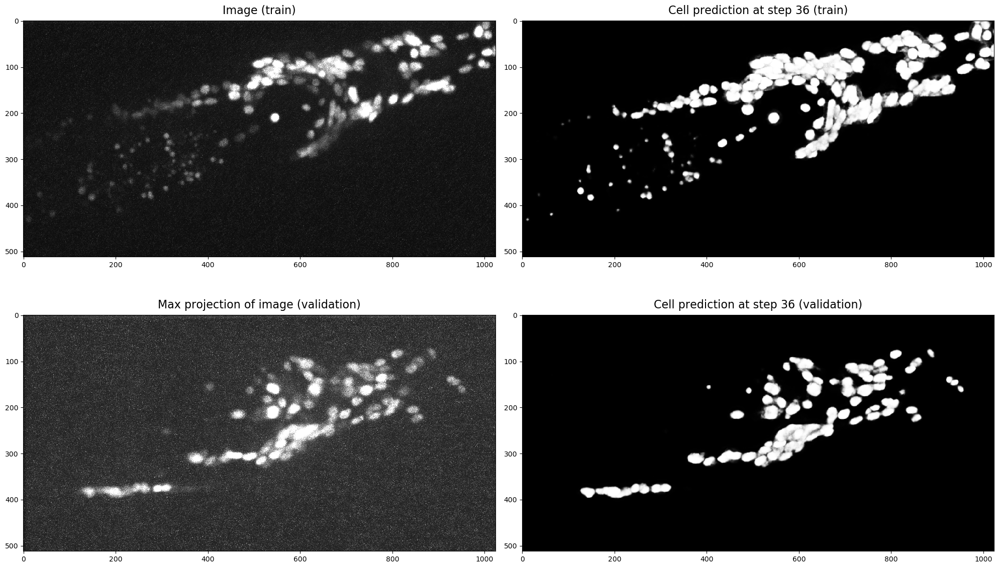

60/60 [==============================] - 50s 833ms/step - loss: 0.0238 - val_loss: 0.0120
val_loss updated from  0.013476755091687664  to  0.012007470792418139


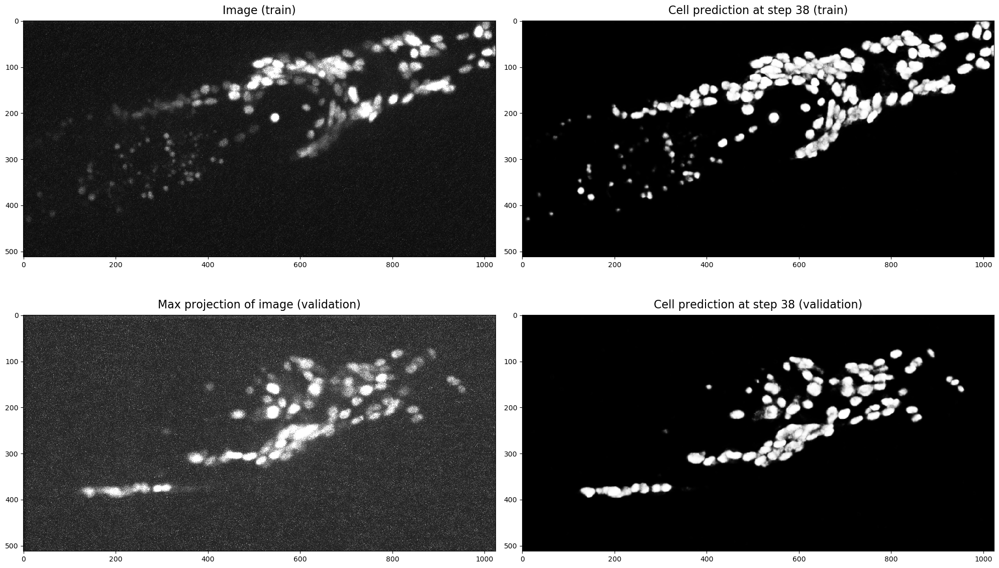

60/60 [==============================] - 50s 834ms/step - loss: 0.0201 - val_loss: 0.0099
val_loss updated from  0.012007470792418139  to  0.009911702454297079


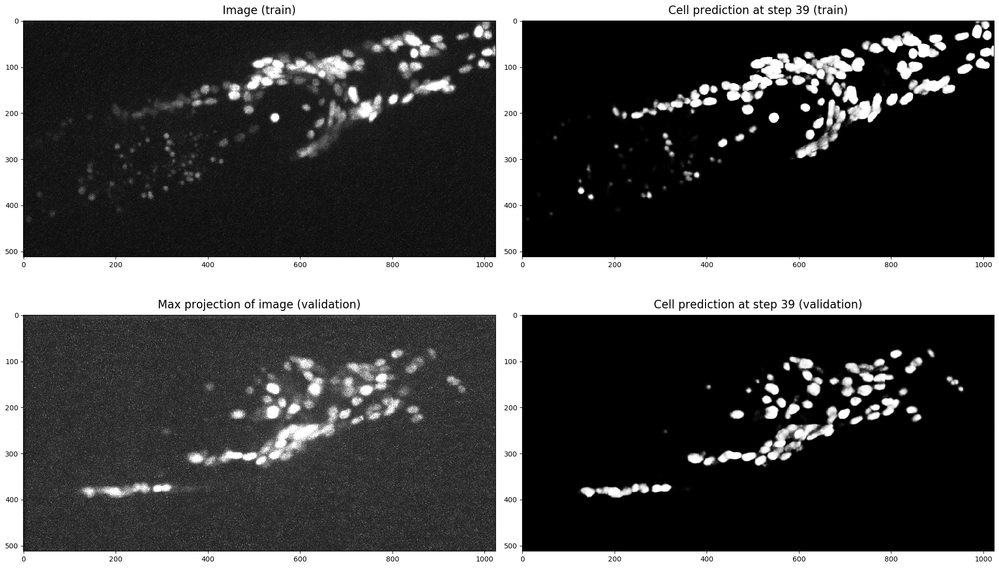

60/60 [==============================] - 50s 834ms/step - loss: 0.0167 - val_loss: 0.0090
val_loss updated from  0.009911702454297079  to  0.00900040061161336


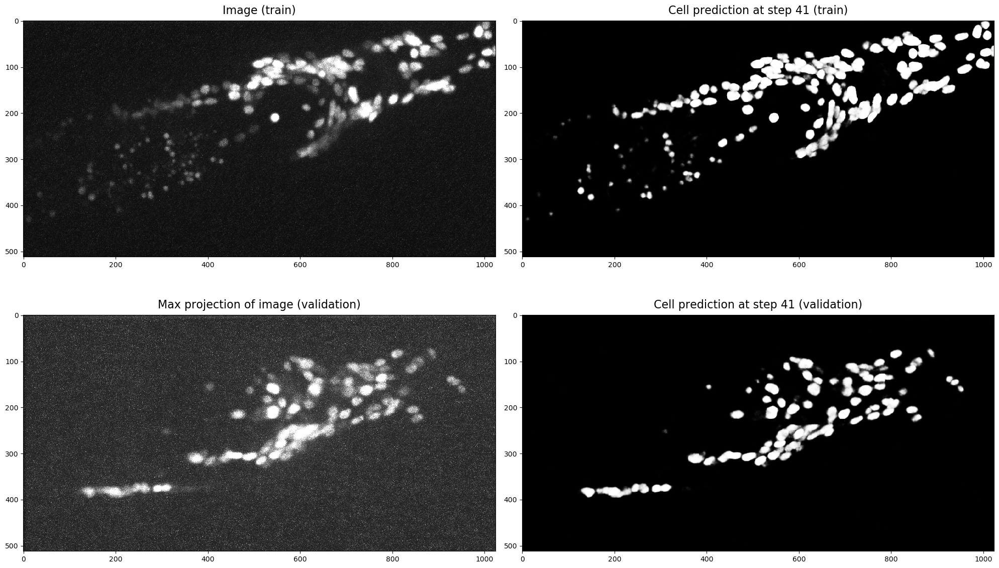

60/60 [==============================] - 50s 837ms/step - loss: 0.0169 - val_loss: 0.0075
val_loss updated from  0.00900040061161336  to  0.007475261744224958


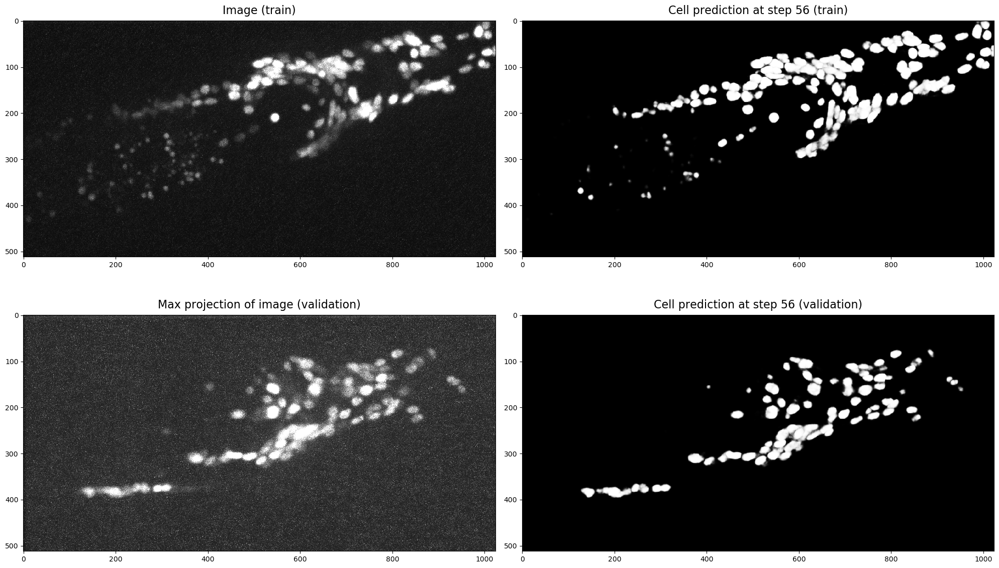

60/60 [==============================] - 51s 858ms/step - loss: 0.0130 - val_loss: 0.0117


In [6]:
trainer.train()

## F. Select the best weights and save the model
After training finished or manually stopped. Users should choose the best step which generate the best prediction of
cell regions. Usually this should be the one with the lowest val_loss, but uses can select other step instead.

The program will store the model with the chosen weights into the “models” folder with the name “unet3_pretrained.h5”

In [8]:
trainer.select_weights(step=56)